# Milestone-1

**Project:** Monitoring Changes in Surface Water Using Satellite Image Data<br/>
**Deliverable:** Reading of a satellite image using Rasterio and manipulation of the image using keras and TensorFlow 2.0 <br/>

## Notes for the reviewer

* The Co-ordinate Reference System is changed to the world coordinate system, `EPSG 4326`, while writing the JP2 file to GeoTiff format using `rasterio`. 

* The image manipulation is done in `keras` using `ImageDataGenerator`.

* Another example of image manipulation provided at the end, uses tensorflow image method `tf.image.crop_to_bounding_box` to crop out a rectangular area from the originally loaded tiff image, into a new image and save it to disk.
* download_script.py encapsulates the code provided in the tutorial `Part_1_GettingStarted` to download the satellite image from the google drive folder.

In [28]:
import tensorflow as tf

In [29]:
from tensorflow import keras

In [30]:
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import array_to_img
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from numpy import expand_dims

import rasterio
from rasterio import plot

import matplotlib.pyplot as plt

### Open satallite image in rasterio

In [31]:
%run ./download_script.py

In [32]:
imagePath = 'example.jp2'

In [33]:
img = rasterio.open(imagePath, driver = 'JP2OpenJPEG')

In [34]:
def get_properties(image):
    return img.profile

In [35]:
properties = get_properties(img)

In [36]:
display(properties)

{'driver': 'JP2OpenJPEG',
 'dtype': 'uint8',
 'nodata': None,
 'width': 10980,
 'height': 10980,
 'count': 3,
 'crs': CRS({'init': 'epsg:32719'}),
 'transform': (600000.0, 10.0, 0.0, 8000020.0, 0.0, -10.0),
 'affine': Affine(10.0, 0.0, 600000.0,
        0.0, -10.0, 8000020.0),
 'blockxsize': 1024,
 'blockysize': 1024,
 'tiled': True,
 'interleave': 'pixel'}

### Show image

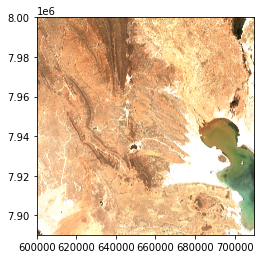

In [37]:
plot.show(img)

### Show each band of the image

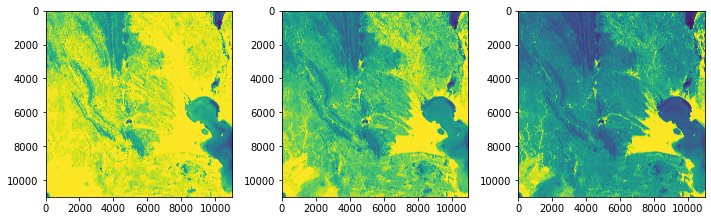

In [38]:
_, axs = plt.subplots(1, 3, figsize = (10,6))
for i in range(0, 3):
    plot.show(img.read(i+1), ax = axs[i])
plt.tight_layout()

### Write the raster image in tif format

In [39]:
kwds = properties
kwds['driver'] = 'GTiff'
kwds['photometric'] = 'YCbCr'
kwds['compress'] = 'JPEG'
kwds['crs'] = 'EPSG:4326'
del kwds['transform']
kwds

{'driver': 'GTiff',
 'dtype': 'uint8',
 'nodata': None,
 'width': 10980,
 'height': 10980,
 'count': 3,
 'crs': 'EPSG:4326',
 'affine': Affine(10.0, 0.0, 600000.0,
        0.0, -10.0, 8000020.0),
 'blockxsize': 1024,
 'blockysize': 1024,
 'tiled': True,
 'interleave': 'pixel',
 'photometric': 'YCbCr',
 'compress': 'JPEG'}

In [40]:
def write_jp2_to_geotiff(img, output_file, parameters):
    gtiff = rasterio.open(output_file, 'w',**parameters)
    for band in range(1, parameters['count']+1):
        #display(band)
        gtiff.write(img.read(band), band)
    gtiff.close()

In [41]:
output_file = 'ex.tiff'
write_jp2_to_geotiff(img, 'ex.tiff', kwds)

In [42]:
original_size = (kwds['height'], kwds['width'])
display(original_size)
scale = 4
new_size = (int(original_size[0]/scale), int(original_size[1]/scale))
new_size

(10980, 10980)

(2745, 2745)

### Loading the tiff image to numpy array

`load_img` will load the image with the scaled down size provided as the argument into a PIL image.

That PIL will then be converted to numpy array with the call to `img_to_array` which would then be used for further transformation.

In [43]:
kimg = load_img(output_file, target_size = new_size)

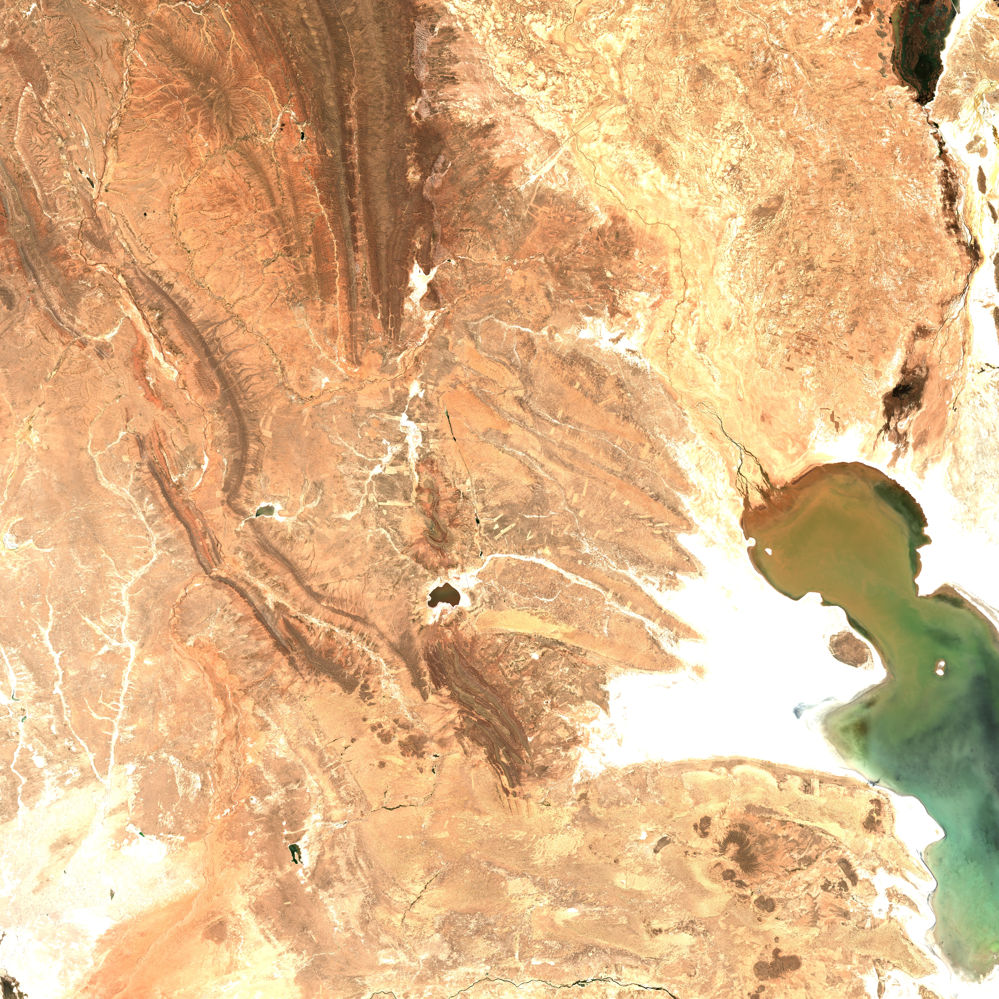

In [44]:
display(kimg)

In [45]:
display(kimg.format)
display(kimg.mode)
display(kimg.size)

None

'RGB'

(2745, 2745)

In [46]:
img_data = img_to_array(kimg)
display(f'Dimensions = {img_data.ndim}')
display(f'Shape = {img_data.shape}')

'Dimensions = 3'

'Shape = (2745, 2745, 3)'

In [47]:
img_data[0]

array([[211., 149., 108.],
       [205., 142., 101.],
       [215., 156., 116.],
       ...,
       [ 86.,  69.,  53.],
       [ 74.,  49.,  29.],
       [144., 101.,  66.]], dtype=float32)

In [48]:
X = expand_dims(img_data, 0)

In [49]:
display(f'Dimensions = {X.ndim}')
display(f'Shape = {X.shape}')

'Dimensions = 4'

'Shape = (1, 2745, 2745, 3)'

### Image manipulation

Image would be manipulated by shift in width, height, zoom, and rotation. Out of boundry pixels are filled with constant mode.

ImageDataGenerator is being used to create batches of tensor with the augmented/transformed data.

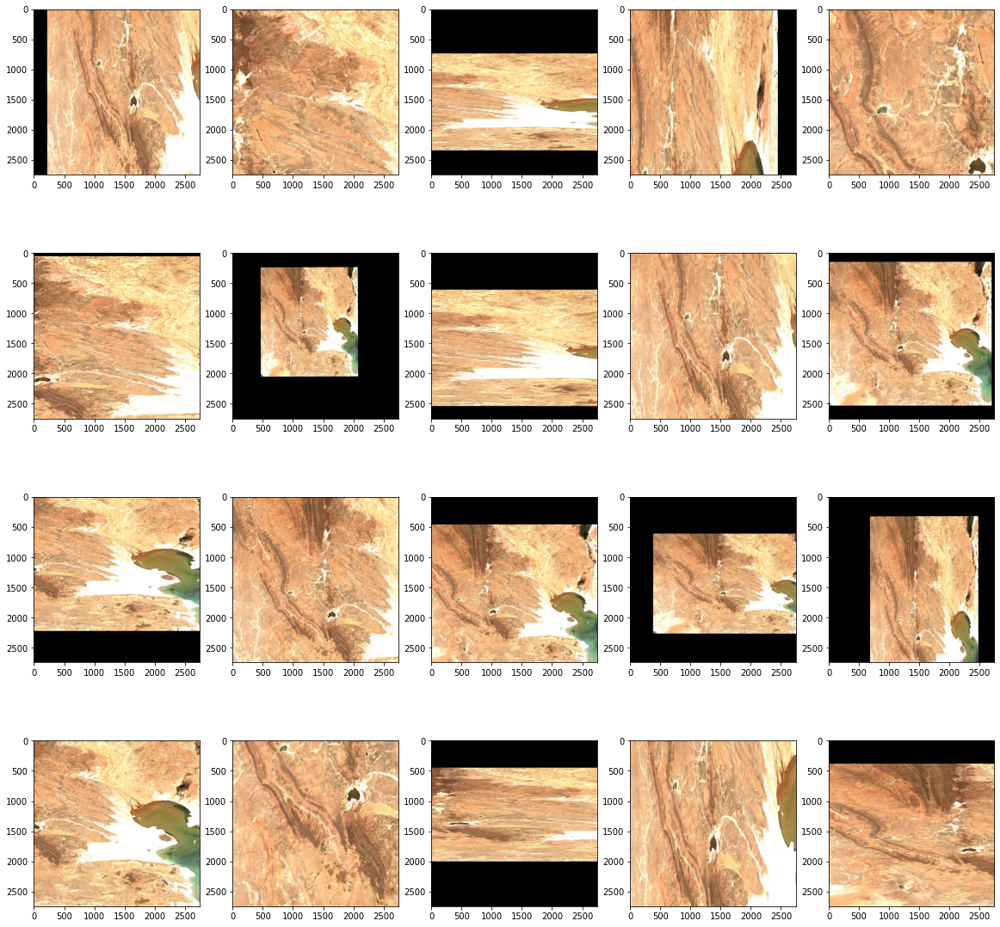

In [50]:
datagen = ImageDataGenerator(width_shift_range = 0.2,
                             height_shift_range = 0.2, 
                             zoom_range = 0.8,
                             rotation_range = 0.2, 
                             fill_mode = 'constant')

it = datagen.flow(X, batch_size = 1)
cols = 5
rows = 4
_, axs = plt.subplots(rows, cols, figsize = (20,20))
axs = axs.flatten()

for i in range(rows*cols):
    batch = it.next()
    image = batch[0].astype('uint8')
    axs[i].imshow(image)

In [51]:
offset_height = 1500
offset_width = 1500
target_height = 1000
target_width = 1000

cropped = tf.image.crop_to_bounding_box(
    X, offset_height, offset_width, target_height, target_width
)

In [52]:
cropped_image = array_to_img(cropped[0])

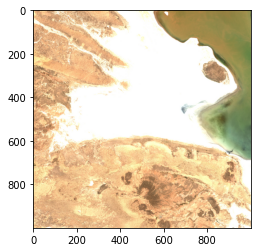

In [53]:
plt.imshow(cropped_image)

In [54]:
cropped_image.save('cropped.png')

## Reference
https://rasterio.readthedocs.io/en/latest/topics/writing.html
https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/image/load_img
https://liveproject.manning.com/project/106
https://machinelearningmastery.com/how-to-configure-image-data-augmentation-when-training-deep-learning-neural-networks/
https://www.youtube.com/watch?v=3kj8uoOlwjg
